# **Recomendador de Musica con Base de Datos de Spotify**

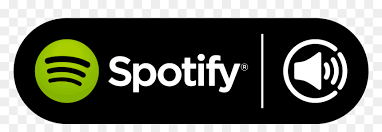

En esta notebook se realizará un motor de Recomendación de Canciones a partir de una base de datos pequeña de spotify.
Empezaré con un EDA para saber como utilizar el dataset. Luego ya que tenga entienda la base la ajustare al problema para que pueda ser mas facil de utilizarla.

**Objetivo**
El objetivo de esta libreta es realizar un Motor de Recomendación de Canciones utilizando una base de datos pequeña de Spotify y el algoritmo K-Medias.

# **Librerias**

#### Importar las librerías

1. Librerías para la manipulación de datos
2. Spotify
3. Configuración del sistema
4. Inteligencia Artificial
5. Big Data (Spark)

In [1]:
pip install -r requirements.txt

Note: you may need to restart the kernel to use updated packages.


You should consider upgrading via the 'C:\virtual_env\Sonia\SoniaM\Scripts\python.exe -m pip install --upgrade pip' command.


In [2]:
# Manipulación de datos ═══════════════════════════════════════════
import numpy as np
import pandas as pd
from collections import defaultdict

# Graficación ═════════════════════════════════════════════════════════
import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt

# Spotify ═════════════════════════════════════════════════════════
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials

# Configuración del sistema ═══════════════════════════════════════
import os
import warnings
import json

warnings.filterwarnings("ignore")
os.environ["PYARROW_IGNORE_TIMEZONE"] = "1"

# Inteligencia Artificial ═════════════════════════════════════════
from scipy.spatial.distance import cdist
from yellowbrick.target import FeatureCorrelation


# Big Data (Spark) ════════════════════════════════════════════════
from pyspark.sql import SparkSession
from pyspark.sql.functions import *
import pyspark.pandas as ps
from pyspark.ml.clustering import KMeans
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.feature import StandardScaler
from pyspark.ml.evaluation import ClusteringEvaluator

%matplotlib inline

In [3]:
spark = SparkSession.builder.appName('Spotify Recommender').getOrCreate()
spark.conf.set("spark.sql.execution.arrow.enabled", "true")
spark


In [4]:
data_s = spark.read.csv('data/data.csv', sep=',', inferSchema=True, header=True)
#data_s = spark.read.csv('spotify_tracks.csv', sep=',', inferSchema=True, header=True)
type(data_s)

pyspark.sql.dataframe.DataFrame

# **Leemos los Datos**

In [5]:
print(data_s.printSchema())

root
 |-- valence: double (nullable = true)
 |-- year: integer (nullable = true)
 |-- acousticness: double (nullable = true)
 |-- artists: string (nullable = true)
 |-- danceability: string (nullable = true)
 |-- duration_ms: string (nullable = true)
 |-- energy: string (nullable = true)
 |-- explicit: string (nullable = true)
 |-- id: string (nullable = true)
 |-- instrumentalness: string (nullable = true)
 |-- key: string (nullable = true)
 |-- liveness: string (nullable = true)
 |-- loudness: string (nullable = true)
 |-- mode: string (nullable = true)
 |-- name: string (nullable = true)
 |-- popularity: string (nullable = true)
 |-- release_date: string (nullable = true)
 |-- speechiness: string (nullable = true)
 |-- tempo: string (nullable = true)

None


In [6]:
data_s.select('id','name','popularity','danceability','instrumentalness','liveness','loudness').show(10)

+--------------------+--------------------+----------+------------------+----------------+--------+-------------------+
|                  id|                name|popularity|      danceability|instrumentalness|liveness|           loudness|
+--------------------+--------------------+----------+------------------+----------------+--------+-------------------+
|4BJqT0PrAfrxzMOxy...|Piano Concerto No...|         4|             0.279|           0.878|   0.665|            -20.096|
|7xPhfUan2yNtyFG0c...|Clancy Lowered th...|         5|0.8190000000000001|             0.0|    0.16|            -12.441|
|1o6I8BglA6ylDMrIE...|           Gati Bali|         5|             0.328|           0.913|   0.101|             -14.85|
|3ftBPsC5vPBKxYSee...|           Danny Boy|         3|             0.275|        2.77e-05|   0.381|             -9.316|
|4d6HGyGT8e121BsdK...|When Irish Eyes A...|         2|             0.418|        1.68e-06|   0.229|            -10.096|
|4pyw9DVHGStUre4J6...|        Gati Mardi

In [7]:
genre_data = pd.read_csv('data/data_by_genres.csv')
year_data = pd.read_csv('data/data_by_year.csv')

Se tienen 3 archivos csv que el primero llamado data.csv cuenta con 19 columnas, genre_data cuenta con 14 columnas y el ultimo cuenta con 14 columnas.

In [8]:
# Conversión de tipos.
#data_s = data_s.withColumn("duration"        ,col("duration")        .cast("double"))
data_s = data_s.withColumn("duration_ms"        ,col("duration_ms")        .cast("double"))
data_s = data_s.withColumn("explicit"        ,col("explicit")        .cast("double"))
data_s = data_s.withColumn("energy"          ,col("energy")          .cast("double"))
data_s = data_s.withColumn("popularity"      ,col("popularity")      .cast("double"))
data_s = data_s.withColumn("danceability"    ,col("danceability")    .cast("double"))
data_s = data_s.withColumn("instrumentalness",col("instrumentalness").cast("double"))
data_s = data_s.withColumn("liveness"        ,col("liveness")        .cast("double"))
data_s = data_s.withColumn("loudness"        ,col("loudness")        .cast("double"))
data_s = data_s.withColumn("valence"         ,col("valence")         .cast("double"))
data_s = data_s.withColumn("speechiness"     ,col("speechiness")     .cast("double"))
data_s = data_s.withColumn("tempo"           ,col("tempo")           .cast("double"))
data_s = data_s.withColumn("key"             ,col("key")             .cast("double"))
data_s = data_s.withColumn("mode"            ,col("mode")            .cast("double"))
data_s = data_s.withColumn("acousticness"    ,col("acousticness")    .cast("double"))
# Conteo de datos faltantes o datos basura.
data_s = data_s.na.fill(value=0)
data_s.select([count(when(isnan(c) | col(c).isNull(), c)).alias(c) for c in data_s.columns]).show()

+-------+----+------------+-------+------------+-----------+------+--------+---+----------------+---+--------+--------+----+----+----------+------------+-----------+-----+
|valence|year|acousticness|artists|danceability|duration_ms|energy|explicit| id|instrumentalness|key|liveness|loudness|mode|name|popularity|release_date|speechiness|tempo|
+-------+----+------------+-------+------------+-----------+------+--------+---+----------------+---+--------+--------+----+----+----------+------------+-----------+-----+
|      0|   0|           0|      0|           0|          0|     0|       0|  0|               0|  0|       0|       0|   0|   0|         0|           0|          0|    0|
+-------+----+------------+-------+------------+-----------+------+--------+---+----------------+---+--------+--------+----+----+----------+------------+-----------+-----+



In [9]:
print(data_s.printSchema())

root
 |-- valence: double (nullable = false)
 |-- year: integer (nullable = true)
 |-- acousticness: double (nullable = false)
 |-- artists: string (nullable = true)
 |-- danceability: double (nullable = false)
 |-- duration_ms: double (nullable = false)
 |-- energy: double (nullable = false)
 |-- explicit: double (nullable = false)
 |-- id: string (nullable = true)
 |-- instrumentalness: double (nullable = false)
 |-- key: double (nullable = false)
 |-- liveness: double (nullable = false)
 |-- loudness: double (nullable = false)
 |-- mode: double (nullable = false)
 |-- name: string (nullable = true)
 |-- popularity: double (nullable = false)
 |-- release_date: string (nullable = true)
 |-- speechiness: double (nullable = false)
 |-- tempo: double (nullable = false)

None


In [10]:
#import pyspark.pandas as ps
#data_s.to_pandas_on_spark()

data = data_s.toPandas()
#data=data_s.toPandas()

In [11]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int32  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  float64
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  float64
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  float64
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  float64
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  float64
 16  release_date      17

In [12]:
print(genre_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB
None


In [13]:
print(year_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB
None


Vamos a comprobar todos los parametros con la columna **'popularidad'**. Antes de ir a hacer eso vamos a comprobar la Correlación de Características considerando algunas características y para eso, voy a utilizar el paquete **yellowbrick**. Puedes aprender más sobre él en la página [documentation](https://www.scikit-yb.org/en/latest/index.html).

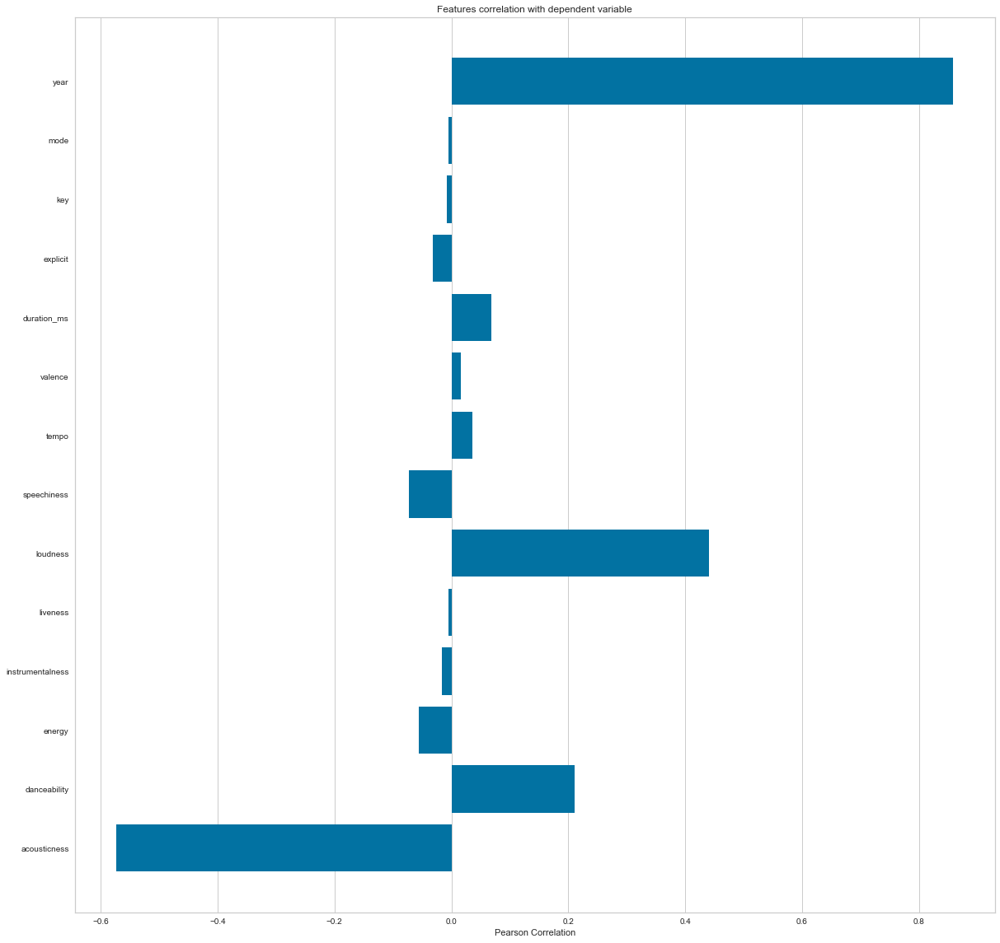

<AxesSubplot:title={'center':'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [28]:
feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year']
#feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
#       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode']

X, y = data[feature_names], data['popularity']

# Creamos una lista con los nombres de las caracteristicas
features = np.array(feature_names)

# Creamos la instancia
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize']=(20,20)
visualizer.fit(X, y)
visualizer.show()

En estadística, el coeficiente de correlación de Pearson es una medida de dependencia lineal entre dos variables aleatorias cuantitativas. A diferencia de la covarianza, la correlación de Pearson es independiente de la escala de medida de las variables.

De manera menos formal, podemos definir el coeficiente de correlación de Pearson como un índice que puede utilizarse para medir el grado de relación de dos variables siempre y cuando ambas sean cuantitativas y continuas. 

# **Analisis Exploratorio de Datos**

# **Música a lo largo del tiempo**


Usando los datos agrupados por año, podemos entender cómo ha cambiado el sonido general de la música desde 1921 hasta 2020.



In [15]:
def get_decade(year):
    period_start = int(year/10) * 10
    decade = '{}s'.format(period_start)
    return decade

data['decade'] = data['year'].apply(get_decade)

sns.set(rc={'figure.figsize':(11 ,6)})
sns.countplot(data['decade'])

In [16]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(year_data, x='year', y=sound_features)
fig.show()

# **Características de los diferentes géneros**

Este conjunto de datos contiene las características de audio de diferentes canciones junto con las características de audio de diferentes géneros. Podemos utilizar esta información para comparar diferentes géneros y comprender sus diferencias únicas de sonido.

In [17]:
top10_genres = genre_data.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()

# **Agrupación de géneros con K-Means**

En este caso, se utiliza el algoritmo simple de agrupación K-means para dividir los géneros de este conjunto de datos en diez clústeres basados en las características numéricas de audio de cada género.

In [18]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])
X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

In [19]:
# Visualizing the Clusters with t-SNE

from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.005s...
[t-SNE] Computed neighbors for 2973 samples in 0.273s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.110184
[t-SNE] KL divergence after 1000 iterations: 1.390995


# **Agrupación de canciones con K-Means**

In [20]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=False))
                                 ], verbose=False)

# number_cols = [ 'danceability',  'energy', 'explicit',
#                'loudness', 'popularity', 'tempo']


number_cols = ['acousticness', 'danceability', 'energy', 'instrumentalness',
'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year']
#number_cols = ['acousticness', 'danceability', 'energy', 'instrumentalness',
#'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode']

X = data[number_cols]
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [21]:
from sklearn.decomposition import PCA

# Visualizing the Clusters with PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

# **Construcción del Motor de recomendación**

* Según el análisis y las visualizaciones, está claro que los géneros similares tienden a tener puntos de datos que se ubican cerca unos de otros, mientras que los tipos de canciones similares también se agrupan.
* Esta observación tiene mucho sentido. Los géneros similares sonarán de manera similar y provendrán de períodos de tiempo similares, mientras que lo mismo puede decirse de las canciones dentro de esos géneros. Podemos usar esta idea para construir un sistema de recomendación tomando los puntos de datos de las canciones que un usuario ha escuchado y recomendando canciones correspondientes a puntos de datos cercanos.
* [Spotipy](https://spotipy.readthedocs.io/en/2.16.1/) es un cliente de Python para la API web de Spotify que facilita a los desarrolladores la obtención de datos y la consulta de canciones en el catálogo de Spotify. Tienes que instalar usando `pip install spotipy`
* Después de instalar Spotipy, deberá crear una aplicación en la [página del desarrollador de Spotify] (https://developer.spotify.com/) y guardar su ID de cliente y clave secreta.


# *Función para encontrar atributos de la cancion como el año*

In [22]:
sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id="62cfe79d83ef43c69a7ba63f9f5debda",
                                                           client_secret="88e6707695634f04a75301fcc77d7789"))

def find_song(name):
    song_data = defaultdict()
    results = sp.search(q= 'track: {}'.format(name), limit=1)
    if results['tracks']['items'] == []:
        return None
    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['explicit'] = [int(results['explicit'])]
    # song_data['duration'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]
    # song_data['loudness'] = [results['loudness']]
    # song_data['danceability'] = [results['danceability']]
    # song_data['energy'] = [results['energy']]
    # song_data['tempo'] = [results['tempo']]
    list_of_dict_values = list(results.values())
    results_string = json.dumps(list_of_dict_values)
    index_release_date = results_string.find("release_date")
    year_index1 = index_release_date + 16
    year_index2 = index_release_date + 17
    year_index3 = index_release_date + 18
    year_index4 = index_release_date + 19
    year_string = results_string[year_index1] + results_string[year_index2] + results_string[year_index3] + results_string[year_index4]
    print(year_string)
    
    song_data['year'] = [int(year_string)]
    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)


In [35]:
# number_cols = ['valence', 'acousticness', 'danceability', 'duration', 'energy', 'explicit',
#  'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']


def get_song_data(song, spotify_data):
    
    #try:
    #    song_data = spotify_data[(spotify_data['name'] == song['name'])].iloc[0]
    #    print(song['name'], ': si esta')
    #    return song_data
    
    #except IndexError:
    print(song['name'], ': no esta')
    return find_song(song['name'])
        

def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict


def recommend_songs( song_list, spotify_data, n_songs=10):
    metadata_cols = ['id','name','artists']
    song_dict = flatten_dict_list(song_list)
    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols]

* Esta última celda te dará una lista de recomendación de canciones

* Puedes cambiar la lista de canciones según tu elección.

In [36]:
recommend_songs([{'name': 'Nothing Else Matters'}],  data)

Nothing Else Matters : no esta
1991


,id,name,artists
164589,3TNiHJztyXXeOTNGE2cm1b,Dead Man's Road,['Cinderella']
49853,5RLv04XXxe0Nc4W7DTBJGT,風繼續吹,['Leslie Cheung']
13820,2lF8jQFhIjpmQa501sYXxR,The Unforgiven,['Metallica']
165899,7cEkyAXkwXCxTR3IKE0XHu,Children - Dream Version,['Robert Miles']
87105,3YRhDlHNJc1kvre4uHB29u,You Lied,['Peach gb']
69193,1wmaAfrbe1JLiyt7SpZeQU,Santa Fe,['Jon Bon Jovi']
134641,11jB63ZyuDjarSyewXSax7,"Behind the Wheel - Live at Rose Bowl, Pasadena...",['Depeche Mode']
13496,46Qy1xAr2K7rylRYwdQ6Gw,House of Pain,['Faster Pussycat']
34191,3Pb9QabepyR9e9D8NqorPH,"Right Here, Right Now",['Fatboy Slim']
